In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import misc
import numpy as np
import os
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential, Model
import PIL
from PIL import Image

In [2]:

df= pd.read_csv('leukemia dataset.csv')

In [3]:
df.head()

,image,label
0,C:\Users\EF\Desktop\Milestone3\leukemia\ALL\20...,ALL
1,C:\Users\EF\Desktop\Milestone3\leukemia\ALL\20...,ALL
2,C:\Users\EF\Desktop\Milestone3\leukemia\ALL\20...,ALL
3,C:\Users\EF\Desktop\Milestone3\leukemia\ALL\20...,ALL
4,C:\Users\EF\Desktop\Milestone3\leukemia\ALL\20...,ALL


In [4]:
df.shape

(1772, 2)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1772 entries, 0 to 1771
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   1772 non-null   object
 1   label   1772 non-null   object
dtypes: object(2)
memory usage: 27.8+ KB


<AxesSubplot:>

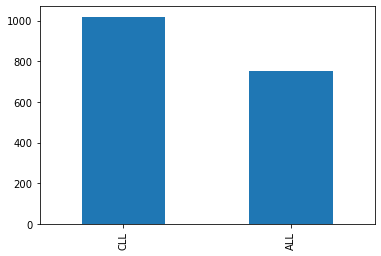

In [6]:
df['label'].value_counts().plot(kind='bar')

In [7]:
image_path_2= df.image[5]
image_path_1770= df.image[1700]

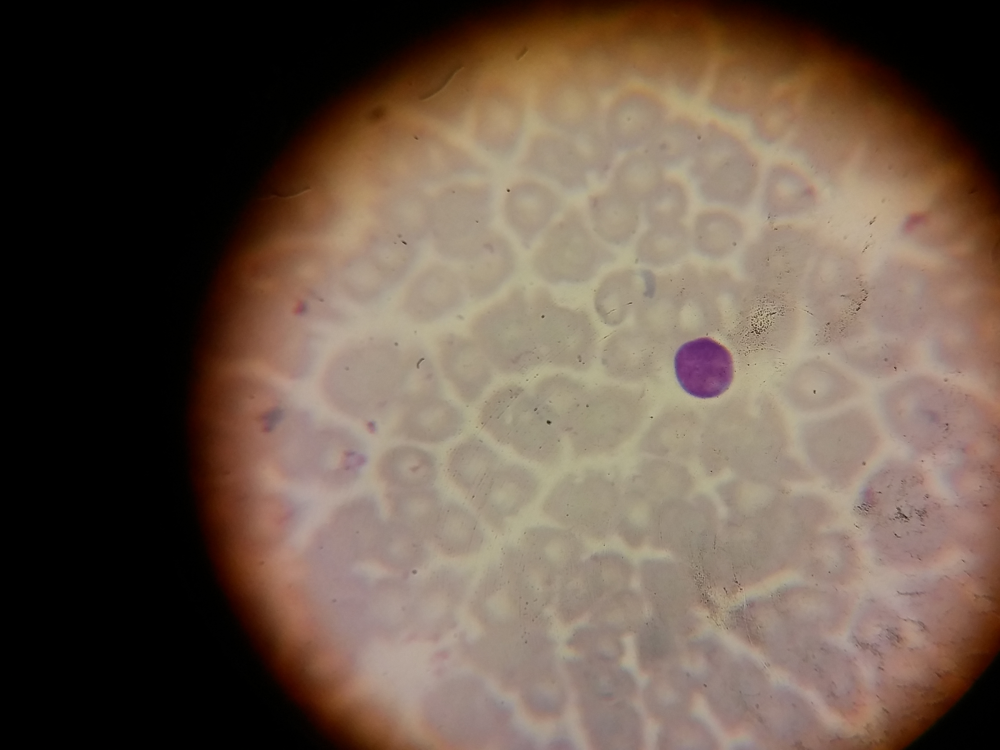

In [8]:
# displaying image of an ALL cell
Image.open(image_path_2)


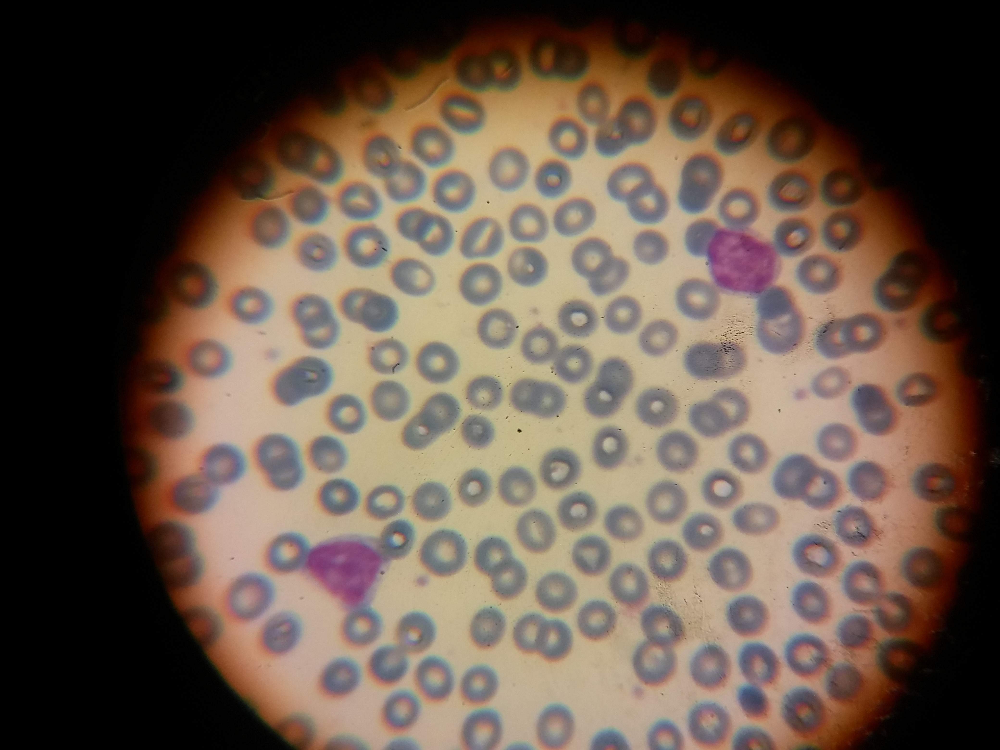

In [9]:
# displaying image of an CLL cell
Image.open(image_path_1770)

In [17]:
import pandas_profiling as pp

In [68]:
pp.ProfileReport(df) 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [44]:
def train_test_split():
    print("########### Train Test Val Script started ###########")
    #data_csv = pd.read_csv("DataSet_Final.csv") ##Use if you have classes saved in any .csv file

    root_dir = r'C:\Users\EF\Desktop\Milestone3\leukemia'
    classes_dir = ['CLL', 'ALL']

    #for name in data_csv['names'].unique()[:10]:
    #    classes_dir.append(name)

    processed_dir = r'C:\Users\EF\Desktop\Milestone3\leukemia'

    val_ratio = 0.20
    test_ratio = 0.20

    for cls in classes_dir:
        # Creating partitions of the data after shuffeling
        print("$$$$$$$ Class Name " + cls + " $$$$$$$")
        src = processed_dir +"//" + cls  # Folder to copy images from

        allFileNames = os.listdir(src)
        np.random.shuffle(allFileNames)
        train_FileNames, val_FileNames, test_FileNames = np.split(np.array(allFileNames),
                                                                  [int(len(allFileNames) * (1 - (val_ratio + test_ratio))),
                                                                   int(len(allFileNames) * (1 - val_ratio)),
                                                                   ])

        train_FileNames = [src + '//' + name for name in train_FileNames.tolist()]
        val_FileNames = [src + '//' + name for name in val_FileNames.tolist()]
        test_FileNames = [src + '//' + name for name in test_FileNames.tolist()]

        print('Total images: '+ str(len(allFileNames)))
        print('Training: '+ str(len(train_FileNames)))
        print('Validation: '+  str(len(val_FileNames)))
        print('Testing: '+ str(len(test_FileNames)))

        # # Creating Train / Val / Test folders (One time use)
        os.makedirs(root_dir + '/train//' + cls)
        os.makedirs(root_dir + '/val//' + cls)
        os.makedirs(root_dir + '/test//' + cls)

        # Copy-pasting images
        for name in train_FileNames:
            shutil.copy(name, root_dir + '/train//' + cls)

        for name in val_FileNames:
            shutil.copy(name, root_dir + '/val//' + cls)

        for name in test_FileNames:
            shutil.copy(name, root_dir + '/test//' + cls)

    print("########### Train Test Val Script Ended ###########")

train_test_split()

########### Train Test Val Script started ###########
$$$$$$$ Class Name CLL $$$$$$$
Total images: 509
Training: 305
Validation: 102
Testing: 102
$$$$$$$ Class Name ALL $$$$$$$
Total images: 377
Training: 226
Validation: 75
Testing: 76
########### Train Test Val Script Ended ###########


In [10]:
train=(r'C:\Users\EF\Desktop\Milestone3\leukemia\train')
test= (r'C:\Users\EF\Desktop\Milestone3\leukemia\test')
val=(r'C:\Users\EF\Desktop\Milestone3\leukemia\val')

In [12]:
# instantiating a pretrained network VGG16 model and using feature extraction 


from tensorflow.keras.applications.vgg16 import VGG16



In [13]:
conv_base= VGG16(weights='imagenet', include_top=False, input_shape=(150,150,3))

In [14]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 150, 150, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 150, 150, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 75, 75, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 75, 75, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 75, 75, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 37, 37, 128)       0     

In [15]:
import os
from keras.preprocessing.image import ImageDataGenerator

In [16]:
datagen= ImageDataGenerator(rescale=1./255)
batch_size=20


In [17]:
def extract_features(directory, sample_count):
    features=np.zeros(shape=(sample_count, 4,4,512))
    labels=np.zeros(shape=(sample_count))
    generator=datagen.flow_from_directory( directory, target_size=(150,150), batch_size=batch_size, class_mode='binary')
    i=0
    for inputs_batch, labels_batch in generator:
        features_batch= conv_base.predict(inputs_batch)
        features[i * batch_size : (i + 1) * batch_size] = features_batch
        labels[i * batch_size : (i + 1) * batch_size]= labels_batch
        i += 1
        if i * batch_size >= sample_count:
            break
        return features, labels



train_features, train_labels = extract_features(train,531 )
validation_features, validation_labels = extract_features(val,177)
test_features, test_labels = extract_features(test,178)

Found 531 images belonging to 2 classes.
Found 177 images belonging to 2 classes.
Found 178 images belonging to 2 classes.


In [18]:
train_features =  np.reshape(train_features, (531, 4 * 4 * 512))
validation_features =  np.reshape(validation_features, (177, 4 * 4 * 512))
test_features =  np.reshape(test_features, (178, 4 * 4 * 512))

In [19]:
from keras import models
from keras import layers
from keras import optimizers


model = models.Sequential()
model.add(layers.Dense(256, activation='relu', input_dim= 4*4*512))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(1, activation='sigmoid'))

          

In [20]:
model.compile(optimizer=keras.optimizers.RMSprop(lr=2e-5), loss='binary_crossentropy', metrics=['acc'])


          

C:\Users\EF\anaconda3.1\lib\site-packages\keras\optimizer_v2\rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


In [21]:
history= model.fit(train_features, train_labels, epochs=10, batch_size=20, validation_data=(validation_features, validation_labels))

Epoch 1/10
27/27 [==============================] - 4s 80ms/step - loss: 0.7028 - acc: 0.9831 - val_loss: 0.6741 - val_acc: 1.0000
Epoch 2/10
27/27 [==============================] - 2s 64ms/step - loss: 0.6911 - acc: 0.9812 - val_loss: 0.6629 - val_acc: 0.9944
Epoch 3/10
27/27 [==============================] - 2s 64ms/step - loss: 0.6805 - acc: 0.9925 - val_loss: 0.6552 - val_acc: 0.9831
Epoch 4/10
27/27 [==============================] - 2s 67ms/step - loss: 0.6782 - acc: 0.9925 - val_loss: 0.6512 - val_acc: 1.0000
Epoch 5/10
27/27 [==============================] - 2s 64ms/step - loss: 0.6760 - acc: 0.9925 - val_loss: 0.6435 - val_acc: 0.9944
Epoch 6/10
27/27 [==============================] - 2s 66ms/step - loss: 0.6751 - acc: 0.9906 - val_loss: 0.6385 - val_acc: 0.9944
Epoch 7/10
27/27 [==============================] - 2s 77ms/step - loss: 0.6679 - acc: 0.9925 - val_loss: 0.6341 - val_acc: 1.0000
Epoch 8/10
27/27 [==============================] - 2s 76ms/step - loss: 0.6633 - a

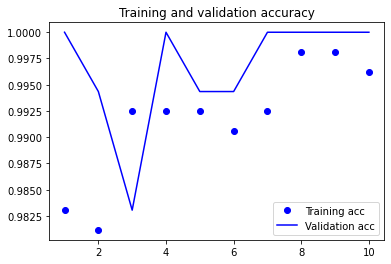

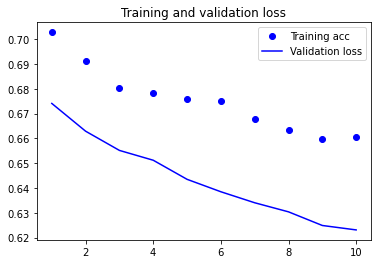

In [22]:
#plotting results

import matplotlib.pyplot as plt

acc= history.history['acc']
val_acc = history.history['val_acc']
loss= history.history['loss']
val_loss= history.history['val_loss']

epochs= range(1, len(acc) + 1)

plt.plot(epochs,acc, 'bo',label='Training acc')
plt.plot(epochs, val_acc, 'b', label= 'Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs,loss, 'bo',label='Training acc')
plt.plot(epochs, val_loss, 'b', label= 'Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

In [35]:
# using VGG16 Conv base and using both feature extraction and data augmentation

from keras import models
from keras import layers

model= models.Sequential()
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))


In [36]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten_3 (Flatten)         (None, 8192)              0         
                                                                 
 dense_7 (Dense)             (None, 256)               2097408   
                                                                 
 dense_8 (Dense)             (None, 1)                 257       
                                                                 
Total params: 16,812,353
Trainable params: 16,812,353
Non-trainable params: 0
_________________________________________________________________


In [37]:
print('this is the nmber of trainable weights before freezing the conv base:', len(model.trainable_weights))

this is the nmber of trainable weightsbefore freezing the conv base: 30


In [38]:
conv_base.trainable=False


In [39]:
print('this is the number of trainable weights' 'after freezing the conv base:', len(model.trainable_weights))


this is the number of trainable weightsafter freezing the conv base: 4


In [40]:
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers

train_datagen= ImageDataGenerator( rescale=1./255, rotation_range=40, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2, zoom_range=0.2, horizontal_flip=True, fill_mode='nearest')



In [41]:
test_datagen= ImageDataGenerator(rescale=1./255)

In [45]:
train_generator= train_datagen.flow_from_directory(train, target_size=(150,150), batch_size=20, class_mode='binary')
validation_generator= test_datagen.flow_from_directory(val, target_size=(150,150), batch_size=20, class_mode='binary')


Found 531 images belonging to 2 classes.
Found 177 images belonging to 2 classes.


In [46]:
model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.RMSprop(lr=2e-5), metrics=['acc'])

In [47]:
history= model.fit_generator(train_generator, steps_per_epoch=1,epochs=10, validation_data=validation_generator, validation_steps=2)

<ipython-input-47-e4522f9e2471>:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history= model.fit_generator(train_generator, steps_per_epoch=1,epochs=10, validation_data=validation_generator, validation_steps=2)


Epoch 1/10
1/1 [==============================] - 91s 91s/step - loss: 0.7143 - acc: 0.5000 - val_loss: 0.6030 - val_acc: 0.8000
Epoch 2/10
1/1 [==============================] - 68s 68s/step - loss: 0.5874 - acc: 0.8000 - val_loss: 0.5476 - val_acc: 0.8500
Epoch 3/10
1/1 [==============================] - 72s 72s/step - loss: 0.5913 - acc: 0.8000 - val_loss: 0.5335 - val_acc: 0.7000
Epoch 4/10
1/1 [==============================] - 64s 64s/step - loss: 0.7046 - acc: 0.4000 - val_loss: 0.5498 - val_acc: 0.9000
Epoch 5/10
1/1 [==============================] - 62s 62s/step - loss: 0.6289 - acc: 0.7000 - val_loss: 0.5104 - val_acc: 0.8500
Epoch 6/10
1/1 [==============================] - 64s 64s/step - loss: 0.5447 - acc: 0.8500 - val_loss: 0.4648 - val_acc: 0.8750
Epoch 7/10
1/1 [==============================] - 64s 64s/step - loss: 0.5604 - acc: 0.7000 - val_loss: 0.5196 - val_acc: 0.9000
Epoch 8/10
1/1 [==============================] - 67s 67s/step - loss: 0.6318 - acc: 0.6500 - val

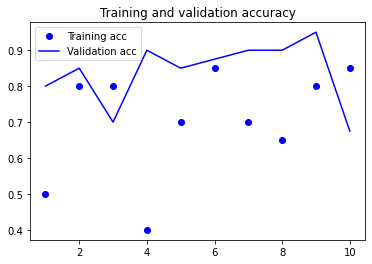

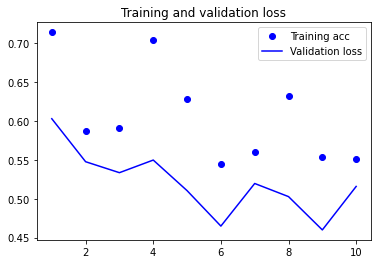

In [48]:
acc= history.history['acc']
val_acc = history.history['val_acc']
loss= history.history['loss']
val_loss= history.history['val_loss']

epochs= range(1, len(acc) + 1)

plt.plot(epochs,acc, 'bo',label='Training acc')
plt.plot(epochs, val_acc, 'b', label= 'Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs,loss, 'bo',label='Training acc')
plt.plot(epochs, val_loss, 'b', label= 'Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

In [26]:
from tensorflow.keras.layers import Conv2D,Dense,MaxPool2D,Flatten
from tensorflow.keras.regularizers import l2

In [27]:
# SVM Image classification

model = Sequential()
model.add(Conv2D(filters = 32, padding = "same",activation = "relu",kernel_size=3, strides = 2,input_shape=(64,64,3)))
model.add(MaxPool2D(pool_size=(2,2),strides = 2))

model.add(Conv2D(filters = 32, padding = "same",activation = "relu",kernel_size=3))
model.add(MaxPool2D(pool_size=(2,2),strides = 2))

model.add(Flatten())
model.add(Dense(128,activation="relu"))

#Output layer
model.add(Dense(1,kernel_regularizer=l2(0.01),activation = "softmax"))

In [30]:
model.compile(optimizer='adam',loss='squared_hinge', metrics = ['acc'])

In [32]:
# some data augmentation

train_datagen = ImageDataGenerator(rescale=(1/255.),shear_range = 0.2,zoom_range=0.2,
                                   horizontal_flip=True)
training_set = train_datagen.flow_from_directory(directory = train,target_size=(64,64),
                                                batch_size=32,
                                                class_mode = "binary")
test_datagen = ImageDataGenerator(rescale=(1/255.))
test_set = test_datagen.flow_from_directory(directory = test,target_size=(64,64),
                                                batch_size=32,
                                                class_mode = "binary")

Found 531 images belonging to 2 classes.
Found 178 images belonging to 2 classes.


In [33]:
history = model.fit(x = training_set, validation_data = test_set, epochs=15)

Epoch 1/15
17/17 [==============================] - 233s 14s/step - loss: 1.7218 - acc: 0.5744 - val_loss: 1.7249 - val_acc: 0.5730
Epoch 2/15
17/17 [==============================] - 239s 14s/step - loss: 1.7177 - acc: 0.5744 - val_loss: 1.7212 - val_acc: 0.5730
Epoch 3/15
17/17 [==============================] - 236s 14s/step - loss: 1.7142 - acc: 0.5744 - val_loss: 1.7182 - val_acc: 0.5730
Epoch 4/15
17/17 [==============================] - 223s 13s/step - loss: 1.7116 - acc: 0.5744 - val_loss: 1.7158 - val_acc: 0.5730
Epoch 5/15
17/17 [==============================] - 219s 13s/step - loss: 1.7094 - acc: 0.5744 - val_loss: 1.7139 - val_acc: 0.5730
Epoch 6/15
17/17 [==============================] - 218s 13s/step - loss: 1.7078 - acc: 0.5744 - val_loss: 1.7124 - val_acc: 0.5730
Epoch 7/15
17/17 [==============================] - 218s 13s/step - loss: 1.7065 - acc: 0.5744 - val_loss: 1.7113 - val_acc: 0.5730
Epoch 8/15
17/17 [==============================] - 218s 13s/step - loss: 1.

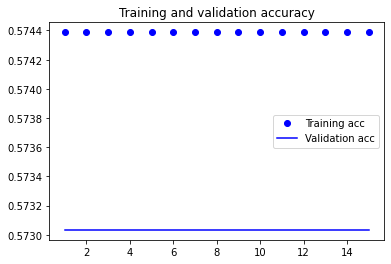

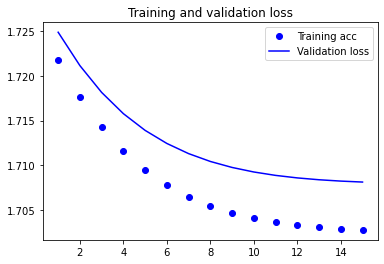

In [34]:
acc= history.history['acc']
val_acc = history.history['val_acc']
loss= history.history['loss']
val_loss= history.history['val_loss']

epochs= range(1, len(acc) + 1)

plt.plot(epochs,acc, 'bo',label='Training acc')
plt.plot(epochs, val_acc, 'b', label= 'Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs,loss, 'bo',label='Training acc')
plt.plot(epochs, val_loss, 'b', label= 'Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()